In [8]:
import random
import numpy as np
import collections
from tqdm import tqdm
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from plot_utils import moving_average
from rl_utils import discretize, undiscretize
import os

os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [9]:
class ReplayBuffer:
    ''' Experience Replay buffer '''
    def __init__(self, capacity):
        self.buffer = collections.deque(maxlen=capacity)  # queue, first in first out

    def add(self, state, action, reward, next_state, done):  # add data to buffer
        self.buffer.append((state, action, reward, next_state, done))

    def sample(self, batch_size):  # sample data from buffer, the number is batch_size
        transitions = random.sample(self.buffer, batch_size)
        state, action, reward, next_state, done = zip(*transitions)
        return np.array(state), action, reward, np.array(next_state), done

    def size(self):  # The current amount of data in the buffer
        return len(self.buffer)

In [10]:
class Qnet(torch.nn.Module):
    def __init__(self, state_dim, action_dim):
        super(Qnet, self).__init__()
        self.fc1 = torch.nn.Linear(state_dim, 256)
        self.fc2 = torch.nn.Linear(256, 128)
        self.fc3 = torch.nn.Linear(128, 64)
        self.fc4 = torch.nn.Linear(64, action_dim)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = torch.relu(self.fc3(x))
        x = self.fc4(x)
        return x

In [11]:
class Environment:
    def __init__(self):
        self.count = 0
        self.death_count = int(np.random.normal(100, 10))
        self.robot_orientation = np.array([np.random.uniform(-np.pi, np.pi),
                                           np.random.uniform(-np.pi/2, np.pi/2)])
        self.robot_position = np.zeros(3)  # position initiale du robot
        self.robot_size = np.full((1,3), 0.1)  # taille du côté du cube représentant le robot
        self.target_zone = np.array([[9, 9, 9], [10, 10, 10]])# position cible
        self.forbidden_zone = np.array([[4.5, 4.5, 4.5], [6.5, 6.5, 6.5]])  # coins de la zone interdite

    # réinitialisation de la position et de la direction du robot
    def reset(self):
        self.count = 0
        self.robot_position = np.zeros(3)  
        self.robot_orientation = np.array([np.random.uniform(-np.pi, np.pi),
                                         np.random.uniform(-np.pi/2, np.pi/2)])
        self.death_count = int(np.random.normal(200, 10))
        return self.get_state()
    
    def dist_to_target(self):
        return np.linalg.norm(self.robot_position - self.target_zone.mean(axis=0))
    
    def obstacle_in_field_of_vision(self, angle_vision=np.pi/12):
        # Convertir l'orientation en vecteur directionnel
        position = self.robot_position
        orientation = self.robot_orientation
        position_obstacle = self.forbidden_zone
        direction = np.array([np.cos(orientation[0]) * np.sin(orientation[1]),
                              np.sin(orientation[0]) * np.cos(orientation[1]),
                              np.sin(orientation[1])])

        # Calculer le vecteur entre la position de l'agent et le centre de l'obstacle
        vector_agent_obstacle = (position_obstacle[0] + position_obstacle[1]) / 2 - position

        # Calculer la distance entre l'agent et le centre de l'obstacle
        distance_agent_obstacle = np.linalg.norm(vector_agent_obstacle)

        # Vérifier si l'obstacle est dans le champ de vision de l'agent
        if distance_agent_obstacle > 0:
            angle_obstacle = np.arccos(np.dot(direction, vector_agent_obstacle) / distance_agent_obstacle)
            if angle_obstacle < angle_vision:
                return 1
        return 0

    def step(self, d_orientation):
        # Mise à jour de l'orientation du robot
        d_orientation = undiscretize(-np.pi/12, np.pi/12, 10, d_orientation)
        self.robot_orientation += d_orientation
        # Mise à jour de la position du robot
        self.robot_position += 1/5 * np.array([np.cos(self.robot_orientation[0]) * np.sin(self.robot_orientation[1]), 
                                               np.sin(self.robot_orientation[0]) * np.cos(self.robot_orientation[1]), 
                                               np.sin(self.robot_orientation[1])])

        # Vérifie si le robot est entré en contact avec la zone interdite
        if self.check_collision(self.robot_position):
            return self.get_state(), -100, True  # collision avec la zone interdite, fin de la simulation
        
        # Vérifie si le robot a atteint la position cible
        if self.check_target_reached(self.robot_position):
            return self.get_state(), 100, True  # robot atteint la position cible, fin de la simulation
        
        if self.is_crashed():
            return self.get_state(), -self.dist_to_target()*5, True # robot crashé, fin de la simulation
        
        self.count += 1
        return self.get_state(), 0, False

    def check_collision(self, position):
        # Vérifie si le robot est en collision avec la zone interdite
        robot_corners = self.get_robot_corners(position)
        for corner in robot_corners:
            if np.all(corner >= self.forbidden_zone[0]) and \
               np.all(corner <= self.forbidden_zone[1]):
                return True
        return False

    def get_robot_corners(self, position):
        # Retourne les coins du cube représentant le robot
        half_size = self.robot_size / 2
        robot_corners = np.array([
            [position[0] - half_size, position[1] - half_size, position[2] - half_size],
            [position[0] - half_size, position[1] - half_size, position[2] + half_size],
            [position[0] - half_size, position[1] + half_size, position[2] - half_size],
            [position[0] - half_size, position[1] + half_size, position[2] + half_size],
            [position[0] + half_size, position[1] - half_size, position[2] - half_size],
            [position[0] + half_size, position[1] - half_size, position[2] + half_size],
            [position[0] + half_size, position[1] + half_size, position[2] - half_size],
            [position[0] + half_size, position[1] + half_size, position[2] + half_size]
        ])
        return robot_corners

    def check_target_reached(self, position):
    
        # Calcule les coordonnées du coin inférieur et du coin supérieur du cube du drone
        drone_lower_corner = position - self.robot_size / 2
        drone_upper_corner = position + self.robot_size / 2
    
        # Vérifie si tous les coins du cube du drone sont contenus dans la zone en forme de pavé droit
        return (np.all(drone_lower_corner >= self.target_zone[0]) and 
                np.all(drone_upper_corner <= self.target_zone[1]))
    
    def is_crashed(self):
        #return np.random.rand() < prob_crash(nstep)
        return self.count == self.death_count

    def get_state(self):
        # Retourne l'état actuel de l'environnement
        distance_to_obstacle = np.linalg.norm(self.robot_position - self.forbidden_zone.mean(axis=0))
        return np.concatenate((self.robot_position, 
                              (self.target_zone[0]+self.target_zone[1])/2, 
                              [self.dist_to_target()],
                               self.robot_orientation,
                              [self.obstacle_in_field_of_vision()]))

In [12]:
class DQN:
    ''' DQN algorithm '''
    def __init__(self, state_dim, action_dim, learning_rate, gamma,
                 epsilon, target_update, device):
        self.action_dim = action_dim
        self.q_net = Qnet(state_dim,
                          self.action_dim).to(device)  # Q network
        # target network
        self.target_q_net = Qnet(state_dim,
                                 self.action_dim).to(device)
        # Use Adam optimizer
        self.optimizer = torch.optim.Adam(self.q_net.parameters(),
                                          lr=learning_rate)
        self.gamma = gamma  # discount factor
        self.epsilon = epsilon  # epsilon-greedy parameter
        self.target_update = target_update  # target network update frequency
        self.count = 0  # counter, record the number of updates
        self.device = device

    def take_action(self, state):  # epsilon-greedy strategy to take action
        if np.random.random() < self.epsilon:
            action = np.random.randint(0,10, size=(2,))
        else:
            state = torch.tensor([state], dtype=torch.float).to(self.device)
            q_values =  self.q_net(state)
            action = discretize(-np.pi/12, np.pi/12, 10, q_values)
        return action

    def update(self, transition_dict):
        states = torch.tensor(transition_dict['states'], dtype=torch.float).to(self.device)
        actions = torch.tensor(transition_dict['actions']).view(-1, self.action_dim).to(self.device)
        rewards = torch.tensor(transition_dict['rewards'], dtype=torch.float).view(-1, 1).to(self.device)
        next_states = torch.tensor(transition_dict['next_states'], dtype=torch.float).to(self.device)
        dones = torch.tensor(transition_dict['dones'], dtype=torch.float).view(-1, 1).to(self.device)

        q_values = self.q_net(states)#.gather(1, actions)  # Q values
        print(q_values)
        # The maximum Q value of the next state
        max_next_q_values = self.target_q_net(next_states).max(1)[0].view(-1, 2)
        print(max_next_q_values)
        #print(max_next_q_values)
        q_targets = rewards + self.gamma * max_next_q_values * (1 - dones)  # TD error target
        dqn_loss = torch.mean(F.mse_loss(q_values, q_targets))  # mean square error loss function
        
        self.optimizer.zero_grad()  # The default gradient in PyTorch will accumulate, here you need to explicitly set the gradient to 0
        dqn_loss.backward()  # Backpropagation update parameters
        self.optimizer.step()

        if self.count % self.target_update == 0:
            self.target_q_net.load_state_dict(
                self.q_net.state_dict())  # update target network
        self.count += 1

In [13]:
lr = 2e-3
num_episodes = 1000
hidden_dim = 128
gamma = 0.98
epsilon = 0.01
target_update = 10
buffer_size = 10000
minimal_size = 500
batch_size = 64
device = torch.device("cuda") if torch.cuda.is_available() \
                              else torch.device("cpu")

env = Environment()
#env._max_episode_steps = 200
#env.seed(0)
#random.seed(0)
#np.random.seed(0)
#torch.manual_seed(0)
replay_buffer = ReplayBuffer(buffer_size)
state_dim = 10
action_dim = 2
agent = DQN(state_dim, action_dim, lr, gamma, epsilon,
            target_update, device)

return_list = []
for i in range(10):
    with tqdm(total=int(num_episodes / 10), desc='Iteration %d' % i) as pbar:
        for i_episode in range(int(num_episodes / 10)):
            episode_return = 0
            state = env.reset()
            done = False
            while not done:
                action = agent.take_action(state)
                next_state, reward, done = env.step(action)
                replay_buffer.add(state, action, reward, next_state, done)
                state = next_state
                episode_return += reward
                # When the number of buffer data exceeds a certain value, Q network training is performed
                if replay_buffer.size() > minimal_size:
                    b_s, b_a, b_r, b_ns, b_d = replay_buffer.sample(batch_size)
                    transition_dict = {
                        'states': b_s,
                        'actions': b_a,
                        'next_states': b_ns,
                        'rewards': b_r,
                        'dones': b_d
                    }
                    agent.update(transition_dict)
            return_list.append(episode_return)
            if (i_episode + 1) % 10 == 0:
                pbar.set_postfix({
                    'episode':
                    '%d' % (num_episodes / 10 * i + i_episode + 1),
                    'return':
                    '%.3f' % np.mean(return_list[-10:])
                })
            pbar.update(1)

Iteration 0:   0%|          | 0/100 [00:00<?, ?it/s]/var/folders/9v/5byhgkld7sj_wbrcvw5cgxrh0000gn/T/ipykernel_96250/2249630970.py:41: RuntimeWarning: invalid value encountered in arccos
  angle_obstacle = np.arccos(np.dot(direction, vector_agent_obstacle) / distance_agent_obstacle)
/var/folders/9v/5byhgkld7sj_wbrcvw5cgxrh0000gn/T/ipykernel_96250/1987068191.py:43: UserWarning: Using a target size (torch.Size([64, 1])) that is different to the input size (torch.Size([64, 2])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  dqn_loss = torch.mean(F.mse_loss(q_values, q_targets))  # mean square error loss function
Iteration 0:   3%|▎         | 3/100 [00:00<00:08, 11.86it/s]

tensor([[-0.1572,  0.1883],
        [-0.1371,  0.2046],
        [-0.1605,  0.1794],
        [-0.2088,  0.1545],
        [-0.1565,  0.2322],
        [-0.1925,  0.2528],
        [-0.1179,  0.1845],
        [-0.2078,  0.2473],
        [-0.1781,  0.1861],
        [-0.1214,  0.2090],
        [-0.1122,  0.0730],
        [-0.1264,  0.1832],
        [-0.1783,  0.2040],
        [-0.2329,  0.2114],
        [-0.1515,  0.2348],
        [-0.1396,  0.2298],
        [-0.0324,  0.0590],
        [-0.1192,  0.1917],
        [-0.0644,  0.1491],
        [-0.1318,  0.2278],
        [-0.2093,  0.2358],
        [-0.2478,  0.2243],
        [-0.1354,  0.1787],
        [-0.1029,  0.2086],
        [-0.0645,  0.1500],
        [-0.1718,  0.1796],
        [-0.2175,  0.2435],
        [-0.2240,  0.1967],
        [-0.2199,  0.2340],
        [-0.1895,  0.2415],
        [-0.1009,  0.1807],
        [-0.1186,  0.2064],
        [-0.1203,  0.2253],
        [-0.0506,  0.0669],
        [-0.2593,  0.1232],
        [-0.1837,  0

Iteration 0:   5%|▌         | 5/100 [00:01<00:25,  3.68it/s]

tensor([[  -0.3093,   -0.2654],
        [  -0.2814,   -0.2569],
        [  -0.9201,   -0.8686],
        [  -0.6572,   -0.6017],
        [  -0.4710,   -0.6605],
        [ -13.2516,  -13.2536],
        [  -0.8506,   -0.8354],
        [  -0.5351,   -0.4903],
        [ -34.1465,  -34.1856],
        [  -0.7067,   -0.6747],
        [  -0.2851,   -0.2582],
        [  -0.6447,   -0.5899],
        [  -0.4541,   -0.4137],
        [  -2.8491,   -2.9012],
        [  -0.7139,   -0.6918],
        [  -0.8149,   -0.7101],
        [  -0.5602,   -0.5333],
        [ -52.2730,  -51.8394],
        [  -0.2951,   -0.2507],
        [  -0.6695,   -0.6240],
        [ -70.9463,  -70.9154],
        [  -0.5905,   -0.6493],
        [  -0.8759,   -0.8293],
        [  -0.3078,   -0.2593],
        [  -0.7172,   -0.7380],
        [  -0.3573,   -0.3102],
        [-109.3735, -109.4661],
        [  -6.2080,   -6.2304],
        [ -49.3871,  -48.9698],
        [  -0.5170,   -0.4823],
        [ -11.4097,  -11.4200],
        

Iteration 0:   6%|▌         | 6/100 [00:01<00:28,  3.33it/s]

tensor([[  -7.3367],
        [ -20.7746],
        [ -36.9735],
        [ -62.3766],
        [  -0.3921],
        [  -5.0529],
        [  -0.3455],
        [  -4.9057],
        [  -0.2207],
        [ -31.9475],
        [ -18.9800],
        [  -0.9297],
        [  -0.5146],
        [ -23.7320],
        [  -0.6499],
        [ -34.7841],
        [  -0.1859],
        [  -0.3909],
        [  -0.2440],
        [  -5.0244],
        [  -0.5401],
        [  -0.4285],
        [ -18.9423],
        [-101.6410],
        [  -0.4388],
        [  -0.5290],
        [ -43.5811],
        [  -9.7198],
        [  -0.4222],
        [ -71.9325],
        [  -0.4855],
        [  -9.8063],
        [ -21.3939],
        [ -34.1870],
        [-116.0694],
        [  -0.5125],
        [ -86.5217],
        [ -32.6870],
        [  -0.3145],
        [ -11.8242],
        [  -0.4616],
        [ -39.6617],
        [ -35.8615],
        [  -0.4720],
        [  -3.4501],
        [  -0.4665],
        [  -3.7277],
        [ -16

Iteration 0:   7%|▋         | 7/100 [00:02<00:31,  2.98it/s]

tensor([[-2.2517e+01, -2.2679e+01],
        [-2.9568e+01, -2.9835e+01],
        [-9.8062e+00, -9.5363e+00],
        [-6.3258e+00, -6.1727e+00],
        [-8.3504e+01, -8.3571e+01],
        [-2.4583e+01, -2.4703e+01],
        [-1.2862e+02, -1.2873e+02],
        [-1.4145e+00, -1.2207e+00],
        [-6.4161e+00, -6.2746e+00],
        [-7.0907e+00, -6.9374e+00],
        [-1.1894e+02, -1.1922e+02],
        [-6.2223e+00, -6.1865e+00],
        [-5.7884e+01, -5.7794e+01],
        [-1.7998e-01, -1.3741e-01],
        [-5.3212e+01, -5.3516e+01],
        [-1.2281e+02, -1.2286e+02],
        [-3.0356e+01, -3.0614e+01],
        [-5.1853e+01, -5.1600e+01],
        [-7.6960e+01, -7.7256e+01],
        [-7.3832e+00, -7.3421e+00],
        [-7.6649e+00, -7.5423e+00],
        [-1.0707e+00, -1.0614e+00],
        [-9.9825e+00, -1.0027e+01],
        [-7.6685e+00, -7.5341e+00],
        [-3.3097e+01, -3.3180e+01],
        [-1.9779e+02, -1.9764e+02],
        [-5.1163e+01, -5.0778e+01],
        [-7.2426e+01, -7.243

Iteration 0:   8%|▊         | 8/100 [00:02<00:32,  2.81it/s]

tensor([[  -8.5103,   -8.5510],
        [ -63.5649,  -63.8054],
        [-115.9766, -116.0152],
        [-170.5117, -170.2665],
        [  -2.8186,   -2.8585],
        [  -9.4991,   -9.5523],
        [-106.6060, -106.5725],
        [ -52.6593,  -53.0702],
        [ -16.3696,  -16.6768],
        [-117.4123, -118.1630],
        [ -28.8786,  -29.3082],
        [  -4.6804,   -4.7000],
        [ -25.7614,  -25.4521],
        [-116.6436, -116.9546],
        [ -27.8119,  -27.4918],
        [ -91.5604,  -91.8648],
        [ -63.9015,  -64.0843],
        [ -93.2352,  -93.9238],
        [ -11.8955,  -12.0026],
        [ -24.1332,  -24.1567],
        [ -97.2491,  -97.5666],
        [ -57.8603,  -58.2537],
        [ -13.9033,  -13.5452],
        [-123.0128, -123.3209],
        [ -11.4632,  -11.5652],
        [ -26.8412,  -26.8257],
        [ -28.9289,  -29.2764],
        [ -92.5416,  -92.8439],
        [  -3.0244,   -3.0500],
        [-122.9420, -122.8265],
        [ -65.3081,  -65.5798],
        

Iteration 0:   9%|▉         | 9/100 [00:02<00:34,  2.65it/s]

tensor([[-9.1319e+01, -9.1713e+01],
        [-3.1961e+01, -3.2214e+01],
        [-2.5216e+01, -2.5448e+01],
        [-7.2242e+01, -7.2216e+01],
        [-5.7157e+01, -5.7255e+01],
        [-8.6481e+00, -8.5898e+00],
        [-1.2375e+01, -1.2265e+01],
        [-8.6927e+01, -8.6742e+01],
        [-6.2787e+01, -6.2683e+01],
        [-2.6566e+01, -2.6504e+01],
        [-1.0220e+02, -1.0189e+02],
        [-1.0489e+01, -1.0622e+01],
        [-1.4420e+01, -1.4206e+01],
        [-2.2915e+01, -2.3081e+01],
        [-5.6713e+01, -5.6836e+01],
        [-5.1961e+01, -5.1974e+01],
        [-3.6762e+01, -3.7027e+01],
        [-1.1691e+01, -1.1767e+01],
        [-5.8019e+01, -5.8114e+01],
        [-4.7193e+01, -4.7098e+01],
        [-8.5349e+01, -8.5477e+01],
        [-2.9498e+01, -2.9732e+01],
        [-6.1960e+00, -6.2174e+00],
        [ 7.3997e-02,  5.6166e-02],
        [-1.6507e+01, -1.6553e+01],
        [-9.2171e+00, -9.1835e+00],
        [-6.4517e+01, -6.4536e+01],
        [-6.0974e+01, -6.104

Iteration 0:  10%|█         | 10/100 [00:03<00:34,  2.63it/s, episode=10, return=-124.530]

tensor([[-4.4090e+01, -4.4239e+01],
        [-9.6018e+01, -9.5437e+01],
        [-2.0817e+01, -2.0751e+01],
        [-1.0068e+02, -1.0007e+02],
        [-5.5070e+01, -5.4849e+01],
        [-8.0808e+01, -8.0483e+01],
        [-1.2701e+01, -1.2535e+01],
        [-2.5312e+01, -2.5211e+01],
        [-1.0145e+00, -1.0207e+00],
        [-2.4555e+01, -2.4677e+01],
        [-4.8367e+01, -4.8469e+01],
        [-5.3662e+01, -5.3768e+01],
        [-4.0131e+00, -4.0883e+00],
        [-1.6230e+01, -1.6394e+01],
        [-1.0888e+01, -1.0859e+01],
        [-4.6491e-01, -4.6463e-01],
        [-6.1353e+01, -6.1297e+01],
        [-3.8042e+01, -3.8044e+01],
        [-1.1603e+01, -1.1656e+01],
        [-6.8480e+01, -6.8202e+01],
        [-4.6760e+00, -4.7363e+00],
        [-5.6707e+00, -5.5355e+00],
        [-2.3353e+01, -2.3495e+01],
        [-2.0980e+01, -2.1139e+01],
        [-1.2123e+01, -1.2147e+01],
        [-5.0798e+00, -5.1301e+00],
        [-5.1169e+01, -5.1183e+01],
        [-3.8167e+01, -3.825

Iteration 0:  11%|█         | 11/100 [00:03<00:36,  2.46it/s, episode=10, return=-124.530]

tensor([[-58.7135, -58.8153],
        [-64.0659, -64.1179],
        [ -9.8448,  -9.7656],
        [ -7.3041,  -7.3201],
        [-22.9264, -22.9076],
        [-22.8232, -22.9004],
        [ -1.1836,  -1.2627],
        [-33.6487, -33.6319],
        [-16.6358, -16.4286],
        [-16.7227, -16.8416],
        [-55.0588, -55.0750],
        [-28.9455, -28.9037],
        [ -1.6107,  -1.6125],
        [-69.4807, -69.5668],
        [-42.6314, -42.6059],
        [-66.0538, -65.8827],
        [-52.1225, -52.1776],
        [-54.1823, -54.0426],
        [ -8.8148,  -8.8211],
        [-58.9447, -58.9600],
        [-32.8768, -32.8189],
        [-48.3162, -48.3093],
        [ -1.8182,  -1.7935],
        [-28.8941, -28.7817],
        [-63.4389, -63.2826],
        [-25.3672, -25.2784],
        [-55.4068, -55.4177],
        [-18.1339, -18.2829],
        [-36.3483, -36.2904],
        [-89.4984, -89.2476],
        [ -1.8470,  -1.7374],
        [ -5.2625,  -5.3507],
        [-56.8066, -56.8599],
        [-

Iteration 0:  12%|█▏        | 12/100 [00:04<00:35,  2.49it/s, episode=10, return=-124.530]

tensor([[ -52.1832,  -51.9394],
        [ -23.2201,  -23.1273],
        [  -4.0502,   -4.1237],
        [ -15.0435,  -15.0735],
        [ -33.1187,  -33.0955],
        [ -50.6922,  -50.6663],
        [ -13.4431,  -13.4388],
        [ -59.2753,  -59.1271],
        [ -60.1436,  -59.9979],
        [ -16.0018,  -15.9145],
        [ -45.3963,  -45.4100],
        [ -18.2785,  -18.2187],
        [ -59.5186,  -59.3427],
        [ -11.1844,  -11.0072],
        [ -13.1552,  -13.1604],
        [ -46.5109,  -46.3525],
        [ -47.8331,  -47.7012],
        [ -33.5728,  -33.3791],
        [ -61.8061,  -61.6554],
        [ -12.3466,  -12.3476],
        [ -41.9546,  -41.9282],
        [ -45.7547,  -45.6103],
        [ -11.9750,  -11.7932],
        [  -8.7213,   -8.6173],
        [ -40.5492,  -40.3955],
        [ -20.5843,  -20.4377],
        [ -42.8357,  -42.8332],
        [  -8.8827,   -8.9070],
        [ -34.4718,  -34.2710],
        [  -2.0472,   -2.1508],
        [ -32.3078,  -32.1632],
        

Iteration 0:  13%|█▎        | 13/100 [00:04<00:35,  2.48it/s, episode=10, return=-124.530]

tensor([[ -21.5635],
        [ -31.1886],
        [ -57.1258],
        [ -58.5220],
        [ -10.4778],
        [ -13.1983],
        [  -4.3854],
        [ -47.1455],
        [ -38.0047],
        [ -60.0490],
        [ -12.7605],
        [  -8.4112],
        [ -34.5451],
        [  -7.9625],
        [ -10.6056],
        [-103.1713],
        [  -3.0240],
        [ -14.1957],
        [ -13.6513],
        [ -21.7140],
        [ -10.3013],
        [ -21.0450],
        [ -69.0420],
        [ -14.2024],
        [-107.5743],
        [  -6.9358],
        [ -12.1562],
        [ -12.0702],
        [ -17.1020],
        [  -7.8815],
        [ -17.1101],
        [ -15.1037],
        [ -22.5694],
        [ -64.6948],
        [  -4.7873],
        [ -35.4360],
        [ -45.1455],
        [ -16.4589],
        [ -30.6889],
        [  -5.2678],
        [ -49.3401],
        [  -4.4605],
        [ -10.7712],
        [ -61.6696],
        [  -8.0020],
        [ -39.1016],
        [ -21.9682],
        [  -1

Iteration 0:  14%|█▍        | 14/100 [00:04<00:35,  2.41it/s, episode=10, return=-124.530]

tensor([[-2.7866e+01, -2.8031e+01],
        [-3.4904e+01, -3.4915e+01],
        [-1.3438e+01, -1.3502e+01],
        [-1.7230e-01, -2.8122e-01],
        [-1.5488e+00, -1.7516e+00],
        [-1.4337e+01, -1.4428e+01],
        [-2.1181e+00, -2.1425e+00],
        [-4.7421e+00, -4.7369e+00],
        [-1.1421e+01, -1.1501e+01],
        [-2.7140e+01, -2.7294e+01],
        [-1.5068e+01, -1.5148e+01],
        [-4.9595e+00, -5.0484e+00],
        [-2.0136e+00, -2.2001e+00],
        [-3.6055e+01, -3.5937e+01],
        [-1.3106e+00, -1.4322e+00],
        [-7.3041e+01, -7.3061e+01],
        [-3.8693e+01, -3.8623e+01],
        [-5.8737e+01, -5.8609e+01],
        [-7.7764e+00, -7.7981e+00],
        [-4.3992e+01, -4.3825e+01],
        [-1.0509e+01, -1.0570e+01],
        [-4.7411e+01, -4.7343e+01],
        [-1.2282e+01, -1.2376e+01],
        [-3.0165e+00, -3.0379e+00],
        [-2.6891e+00, -2.8804e+00],
        [-4.0828e+00, -4.1743e+00],
        [-5.3195e+01, -5.3233e+01],
        [-1.9231e+00, -1.880

Iteration 0:  15%|█▌        | 15/100 [00:05<00:36,  2.30it/s, episode=10, return=-124.530]

tensor([[-8.8350e+01, -8.8391e+01],
        [-3.5171e+01, -3.5312e+01],
        [-1.4203e+00, -1.3254e+00],
        [-3.7653e+01, -3.7615e+01],
        [-9.4918e+01, -9.5061e+01],
        [-3.2071e+01, -3.2106e+01],
        [-4.2849e+01, -4.2730e+01],
        [-3.3200e-01, -2.4043e-01],
        [-8.4750e+00, -8.3258e+00],
        [-4.0432e+01, -4.0572e+01],
        [-2.8690e+01, -2.8723e+01],
        [-2.2821e+00, -2.4007e+00],
        [-5.2818e+01, -5.2723e+01],
        [-1.8956e+01, -1.9010e+01],
        [ 1.4409e+00,  1.3349e+00],
        [-2.1592e+01, -2.1443e+01],
        [-1.1219e+01, -1.1278e+01],
        [-3.2325e+00, -3.3574e+00],
        [ 4.2376e-01,  3.3974e-01],
        [-7.0656e+00, -6.9444e+00],
        [-7.4915e+01, -7.4862e+01],
        [-3.9203e+00, -3.9184e+00],
        [-3.9098e+00, -3.9442e+00],
        [-7.3708e+00, -7.3969e+00],
        [-1.9664e+01, -1.9659e+01],
        [-8.5874e+01, -8.5963e+01],
        [-5.4430e+01, -5.4455e+01],
        [-1.3591e+01, -1.351

Iteration 0:  16%|█▌        | 16/100 [00:05<00:36,  2.31it/s, episode=10, return=-124.530]

tensor([[ -15.4370,  -15.3988],
        [   1.3631,    1.2626],
        [ -25.4124,  -25.2749],
        [ -38.0094,  -37.9281],
        [ -77.3076,  -77.2988],
        [ -49.7290,  -49.6822],
        [   0.5786,    0.5859],
        [ -14.0827,  -14.0435],
        [  -2.1860,   -2.1681],
        [ -11.9353,  -11.8887],
        [  -2.0499,   -2.0331],
        [ -15.7109,  -15.6933],
        [ -50.3078,  -50.3645],
        [  -9.4604,   -9.3996],
        [ -66.8576,  -66.9331],
        [ -99.8001,  -99.8924],
        [-106.5526, -106.6510],
        [  -4.4886,   -4.4744],
        [ -12.4980,  -12.5111],
        [  -8.3175,   -8.3504],
        [ -78.5663,  -78.6338],
        [ -21.4926,  -21.4142],
        [ -41.0010,  -41.1195],
        [ -47.9501,  -48.0135],
        [  -5.5449,   -5.6034],
        [ -47.5067,  -47.6744],
        [  -0.5382,   -0.5445],
        [-127.5726, -127.3420],
        [  -4.2666,   -4.1689],
        [  -4.2819,   -4.2615],
        [   0.4150,    0.3938],
        

Iteration 0:  17%|█▋        | 17/100 [00:06<00:35,  2.32it/s, episode=10, return=-124.530]

tensor([[ -13.9373,  -13.9473],
        [ -81.3705,  -81.5105],
        [  -3.9271,   -4.0312],
        [ -29.1908,  -29.0055],
        [  -3.5154,   -3.5201],
        [ -19.7707,  -19.8299],
        [ -44.3366,  -44.2825],
        [  -7.8746,   -7.8427],
        [ -40.9621,  -41.0520],
        [  -8.9017,   -8.8883],
        [  -1.9063,   -1.9350],
        [ -39.6445,  -39.7257],
        [ -20.1183,  -20.0128],
        [-122.4916, -122.4183],
        [  -7.1555,   -7.1570],
        [ -17.8571,  -17.8985],
        [ -49.5733,  -49.6430],
        [ -58.4905,  -58.4999],
        [ -54.5612,  -54.5346],
        [  -5.2054,   -5.1630],
        [-112.1951, -112.2296],
        [  -1.9449,   -1.9774],
        [  -2.9398,   -2.9439],
        [ -82.4388,  -81.8791],
        [  -7.1120,   -7.1062],
        [-117.6763, -117.5846],
        [ -24.8648,  -24.8282],
        [  -6.4473,   -6.4395],
        [  -7.9065,   -7.8077],
        [ -10.7275,  -10.9199],
        [-130.0920, -130.1596],
        

Iteration 0:  18%|█▊        | 18/100 [00:06<00:35,  2.29it/s, episode=10, return=-124.530]

tensor([[ -12.5002,  -12.5114],
        [  -4.1853,   -4.2182],
        [  -6.7098,   -6.6940],
        [  -4.8946,   -4.9298],
        [  -9.5073,   -9.5236],
        [ -13.8368,  -13.8443],
        [ -17.2654,  -17.2825],
        [  -7.7833,   -7.8143],
        [ -29.1034,  -29.0546],
        [ -29.1123,  -29.1788],
        [  -7.6716,   -7.7109],
        [ -56.3094,  -56.4116],
        [  -8.3207,   -8.2951],
        [ -59.9335,  -60.0764],
        [  -5.0983,   -5.1222],
        [ -49.8869,  -49.7845],
        [ -40.8983,  -41.0220],
        [  -2.4997,   -2.4835],
        [  -4.6597,   -4.6943],
        [  -4.6753,   -4.6667],
        [ -95.2254,  -95.3612],
        [ -14.9899,  -15.0054],
        [ -65.0736,  -64.9653],
        [  -5.0889,   -5.1571],
        [ -28.8909,  -28.9962],
        [  -2.6436,   -2.6368],
        [ -28.9027,  -28.9520],
        [  -2.5660,   -2.5462],
        [ -31.4639,  -31.4890],
        [ -22.3645,  -22.3915],
        [ -72.4371,  -72.4239],
        

Iteration 0:  19%|█▉        | 19/100 [00:07<00:36,  2.24it/s, episode=10, return=-124.530]

tensor([[ -15.1410,  -15.3285],
        [  -9.4445,   -9.5854],
        [ -37.6916,  -37.9673],
        [ -32.5536,  -32.8874],
        [ -21.1652,  -21.4415],
        [  -3.3670,   -3.4634],
        [ -52.6177,  -52.8079],
        [ -31.9810,  -32.1891],
        [ -11.2836,  -11.6283],
        [  -4.2317,   -4.3373],
        [  -6.8005,   -6.9381],
        [ -25.8450,  -25.8656],
        [ -42.0237,  -42.1869],
        [ -44.1489,  -44.2855],
        [ -62.3984,  -62.5838],
        [ -20.5722,  -20.5730],
        [ -28.8375,  -29.2115],
        [ -35.8974,  -36.2145],
        [  -6.4303,   -6.5465],
        [  -4.7637,   -4.8749],
        [ -55.0214,  -55.1936],
        [  -7.4488,   -7.5174],
        [ -38.8782,  -39.0026],
        [  -9.5327,   -9.6073],
        [ -11.5877,  -11.7246],
        [  -4.5310,   -4.6461],
        [-104.3749, -104.8394],
        [ -41.7141,  -42.0047],
        [ -42.5040,  -42.6343],
        [ -20.5405,  -20.5145],
        [ -41.4606,  -41.7932],
        

Iteration 0:  20%|██        | 20/100 [00:07<00:36,  2.22it/s, episode=20, return=-128.773]

tensor([[ -48.7767],
        [  -1.8842],
        [ -42.4640],
        [ -59.8398],
        [ -18.9122],
        [ -26.7156],
        [  -3.0422],
        [  -9.9487],
        [  -5.2173],
        [ -92.3082],
        [ -30.1121],
        [ -14.5240],
        [  -9.7252],
        [  -4.0813],
        [  -1.8090],
        [ -14.8020],
        [ -83.5236],
        [  -2.8961],
        [ -16.6650],
        [  -0.6561],
        [  -0.5904],
        [-104.5293],
        [  -5.6601],
        [  -1.8613],
        [  -0.4889],
        [ -13.4169],
        [ -42.9177],
        [  -6.2504],
        [  -2.5992],
        [  -1.9391],
        [  -3.3570],
        [  -4.2503],
        [  -3.0175],
        [ -14.8205],
        [ -12.5276],
        [  -7.6772],
        [ -17.5034],
        [ -16.7522],
        [  -2.1403],
        [ -11.6856],
        [  -5.9999],
        [  -2.7704],
        [  -0.8028],
        [ -23.9155],
        [-113.7814],
        [ -23.9003],
        [ -63.8997],
        [ -11

Iteration 0:  21%|██        | 21/100 [00:08<00:34,  2.27it/s, episode=20, return=-128.773]

tensor([[  -7.9350,   -7.9644],
        [  -2.9684,   -2.9523],
        [  -3.0316,   -3.0337],
        [  -1.8421,   -1.8534],
        [ -23.3347,  -23.2410],
        [ -35.4825,  -35.4043],
        [  -1.2506,   -1.2278],
        [ -14.9571,  -14.9194],
        [ -55.7422,  -55.7698],
        [  -1.5340,   -1.5287],
        [ -53.7516,  -53.6691],
        [  -1.4109,   -1.4208],
        [  -1.8193,   -1.8243],
        [  -9.0361,   -9.0244],
        [-113.6194, -113.6125],
        [-105.5971, -105.7366],
        [ -48.9349,  -48.9161],
        [  -6.3735,   -6.3327],
        [  -1.6846,   -1.6923],
        [  -1.4133,   -1.4262],
        [  -4.1545,   -4.1589],
        [  -1.4849,   -1.4740],
        [  -9.4960,   -9.4888],
        [ -35.8387,  -35.7048],
        [ -32.0511,  -32.0453],
        [ -33.2710,  -33.2374],
        [  -2.0161,   -2.0124],
        [  -2.1061,   -2.0898],
        [  -1.9413,   -1.9309],
        [ -71.1111,  -71.0486],
        [  -1.3564,   -1.3685],
        

Iteration 0:  22%|██▏       | 22/100 [00:08<00:36,  2.16it/s, episode=20, return=-128.773]

tensor([[  -3.8974,   -3.9109],
        [ -30.2263,  -30.1815],
        [ -96.4118,  -96.3837],
        [  -6.4549,   -6.4507],
        [ -10.6966,  -10.6709],
        [ -55.1820,  -55.4266],
        [ -30.9792,  -31.0098],
        [  -4.3660,   -4.3924],
        [  -3.7108,   -3.7318],
        [  -2.2157,   -2.2292],
        [ -52.9766,  -52.9601],
        [  -2.8140,   -2.8306],
        [ -61.7404,  -61.7636],
        [ -24.9487,  -24.8501],
        [ -97.5277,  -97.5459],
        [  -6.6296,   -6.6247],
        [  -4.9612,   -4.8397],
        [ -20.1365,  -20.1164],
        [  -1.7822,   -1.8010],
        [ -91.2573,  -91.2864],
        [  -1.6883,   -1.6846],
        [  -6.1381,   -6.1544],
        [ -39.8169,  -39.9543],
        [  -1.0182,   -1.0166],
        [ -13.5794,  -13.5506],
        [  -4.0291,   -4.0467],
        [  -6.7320,   -6.7163],
        [  -3.7035,   -3.8065],
        [ -89.8953,  -90.0394],
        [  -1.6164,   -1.6361],
        [  -2.5619,   -2.5771],
        

Iteration 0:  23%|██▎       | 23/100 [00:09<00:35,  2.15it/s, episode=20, return=-128.773]

tensor([[ -22.9512,  -22.9292],
        [  -2.4512,   -2.4794],
        [ -75.1674,  -75.2154],
        [  -7.1523,   -7.1922],
        [ -94.9054,  -94.9171],
        [  -6.1825,   -6.2273],
        [  -2.6787,   -2.7025],
        [-109.1742, -109.2810],
        [ -38.9532,  -39.0031],
        [  -0.9754,   -0.9583],
        [  -2.0282,   -2.0257],
        [ -21.1842,  -21.1578],
        [ -37.0397,  -37.1058],
        [ -22.5949,  -22.5417],
        [  -0.8052,   -0.7852],
        [ -63.5238,  -63.5209],
        [ -60.5384,  -60.6824],
        [  -4.9355,   -4.9695],
        [-139.1259, -139.0479],
        [  -4.0275,   -4.0519],
        [ -11.7979,  -11.8109],
        [  -1.1285,   -1.1117],
        [ -39.0517,  -39.0827],
        [  -1.2829,   -1.2655],
        [ -57.8060,  -57.9302],
        [ -16.3079,  -16.3109],
        [  -0.9973,   -0.9827],
        [ -21.2418,  -21.2196],
        [  -1.6744,   -1.6559],
        [ -65.6685,  -65.6470],
        [-113.3216, -113.3031],
        

Iteration 0:  24%|██▍       | 24/100 [00:09<00:36,  2.11it/s, episode=20, return=-128.773]

tensor([[ -44.7863],
        [-110.7197],
        [ -50.7354],
        [-133.7046],
        [  -4.8492],
        [-110.5697],
        [  -1.6107],
        [ -15.2196],
        [  -8.1772],
        [ -24.1485],
        [ -10.6334],
        [  -0.8716],
        [ -19.9178],
        [  -4.5647],
        [  -2.4410],
        [  -2.6749],
        [ -73.6363],
        [  -2.0430],
        [ -75.9157],
        [ -79.8303],
        [ -99.5844],
        [  -9.6957],
        [ -54.8788],
        [ -83.5353],
        [-153.9670],
        [ -71.2665],
        [ -42.7809],
        [ -11.9357],
        [-106.9759],
        [-110.5060],
        [ -50.2570],
        [  -1.6637],
        [ -49.1932],
        [ -13.8354],
        [ -42.7598],
        [ -28.4616],
        [  -9.5744],
        [  -1.5425],
        [  -2.5546],
        [-106.7945],
        [ -33.9353],
        [ -86.8582],
        [ -10.9062],
        [ -59.1281],
        [ -29.9287],
        [  -5.4689],
        [ -21.0503],
        [ -80

Iteration 0:  24%|██▍       | 24/100 [00:09<00:31,  2.45it/s, episode=20, return=-128.773]

tensor([[ -51.0196],
        [  -4.2230],
        [ -41.9707],
        [ -10.8931],
        [ -23.5559],
        [  -1.4533],
        [ -54.1910],
        [ -22.0861],
        [ -77.0039],
        [  -6.8189],
        [ -50.6930],
        [ -17.9062],
        [ -74.5498],
        [  -5.8470],
        [ -71.8716],
        [ -34.3776],
        [ -38.0307],
        [  -6.8706],
        [ -19.2681],
        [  -0.9794],
        [ -39.2621],
        [ -87.0617],
        [  -0.2242],
        [  -0.1481],
        [  -1.0995],
        [ -33.1045],
        [ -92.2896],
        [ -31.1574],
        [-117.5225],
        [ -21.5172],
        [  -1.6533],
        [ -28.6363],
        [  -5.5248],
        [ -24.7675],
        [  -9.7677],
        [  -2.3852],
        [ -19.9080],
        [ -52.1180],
        [ -35.8560],
        [  -5.2327],
        [ -24.2436],
        [  -7.1575],
        [ -51.0393],
        [ -63.2971],
        [  -6.2794],
        [ -14.3701],
        [ -28.7425],
        [ -96

KeyboardInterrupt: 

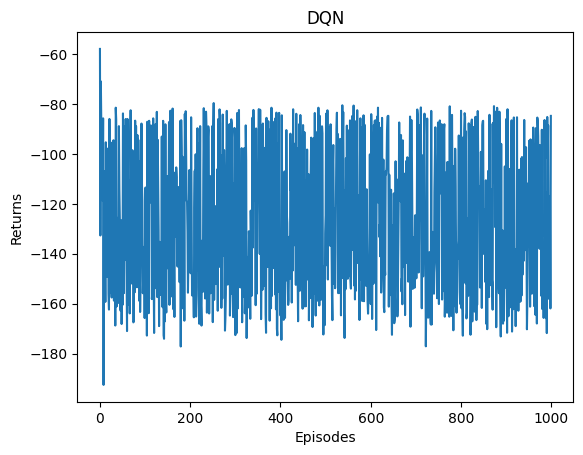

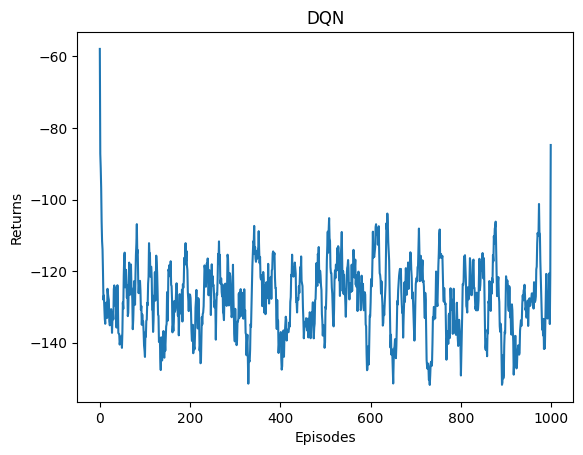

In [ ]:
episodes_list = list(range(len(return_list)))
plt.plot(episodes_list, return_list)
plt.xlabel('Episodes')
plt.ylabel('Returns')
plt.title('DQN')
plt.show()

mv_return = moving_average(return_list, 9)
plt.plot(episodes_list, mv_return)
plt.xlabel('Episodes')
plt.ylabel('Returns')
plt.title('DQN')
plt.show()